# Peter Moss Acute Myeloid & Lymphoblastic Leukemia AI Research Project 

## Acute Lymphoblastic Leukemia

### Introduction 

Leukemia is a blood cancer characterized by a rapid production of abnormal white blood cells called blasts. These malignant cells may be found in the bone marrow, where the blood cells are generated, and in the peripheral blood (i.e. in circulation within the blood vessels). As the disease progresses, the leukemic white blood cells swamp out the healthy blood cells, preventing them to perform their functions, like fighting infections or avoiding serious bleeding.

Like other cancers, there are many types and subtypes of leukemia. The most simple classification includes only four types of leukemia based on two parameters: evolution (chronic or acute), and cell lineage (myeloid or lymphoblastic/lymphocytic. Chronic leukemias typically have an indolent evolution, i.e. progress slowly over the years, whereas acute leukemias are more aggressive and may be fatal in few weeks.


In [37]:
# Load Libraries 
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
from glob import glob
import seaborn as sns
base_tile_dir = os.path.join('..', 'model', 'data')

In [38]:
# Create a dataframe table for further analysis
tile_df = pd.DataFrame({
    'path': glob(os.path.join(base_tile_dir, '*', '*', '*', '*', '*.jpg'))
})
tile_df['file_id'] = tile_df['path'].map(lambda x: os.path.basename(os.path.dirname(x))[0])
tile_df['cell_type'] = tile_df['path'].map(lambda x: os.path.basename(os.path.dirname(x)))
tile_df['cell_type_idx'] = tile_df['cell_type'].map(lambda x: int(x[0]))
tile_df['cell_type'] = tile_df['cell_type'].map(lambda x: int(x[0]))
tile_df['full_image_name'] = tile_df['file_id'].map(lambda x: x[0])
tile_df['full_image_row'] = tile_df['file_id'].map(lambda x: int(x[-1]))
tile_df['full_image_col'] = tile_df['file_id'].map(lambda x: int(x[-1]))
tile_df.sample(5)

,path,file_id,cell_type,cell_type_idx,full_image_name,full_image_row,full_image_col
25,..\model\data\ALL-IDB\ALL_IDB1\im\0\Im075_0.jpg,0,0,0,0,0,0
69,..\model\data\ALL-IDB\ALL_IDB1\im\1\Im011_1.jpg,1,1,1,1,1,1
1,..\model\data\ALL-IDB\ALL_IDB1\im\0\Im035_0.jpg,0,0,0,0,0,0
86,..\model\data\ALL-IDB\ALL_IDB1\im\1\Im028_1.jpg,1,1,1,1,1,1
12,..\model\data\ALL-IDB\ALL_IDB1\im\0\Im046_0.jpg,0,0,0,0,0,0


In [39]:

tile_df['file_id'] = tile_df['path'].map(lambda x: os.path.basename(os.path.dirname(x))[0])
tile_df['cell_type'] = tile_df['path'].map(lambda x: os.path.basename(os.path.dirname(x)))
tile_df['cell_type_idx'] = tile_df['cell_type'].map(lambda x: int(x[0]))
tile_df['cell_type'] = tile_df['cell_type'].map(lambda x: int(x[0]))
tile_df['full_image_name'] = tile_df['file_id'].map(lambda x: x[0])
tile_df['full_image_row'] = tile_df['file_id'].map(lambda x: int(x[-1]))
tile_df['full_image_col'] = tile_df['file_id'].map(lambda x: int(x[-1]))
tile_df.sample(5)

,path,file_id,cell_type,cell_type_idx,full_image_name,full_image_row,full_image_col
92,..\model\data\ALL-IDB\ALL_IDB1\im\1\Im048_1.jpg,1,1,1,1,1,1
93,..\model\data\ALL-IDB\ALL_IDB1\im\1\Im049_1.jpg,1,1,1,1,1,1
31,..\model\data\ALL-IDB\ALL_IDB1\im\0\Im081_0.jpg,0,0,0,0,0,0
12,..\model\data\ALL-IDB\ALL_IDB1\im\0\Im046_0.jpg,0,0,0,0,0,0
26,..\model\data\ALL-IDB\ALL_IDB1\im\0\Im076_0.jpg,0,0,0,0,0,0


In [40]:
# Stats results
tile_df.describe(exclude=[np.number])

,path,file_id,full_image_name
count,108,108,108
unique,108,2,2
top,..\model\data\ALL-IDB\ALL_IDB1\im\0\Im074_0.jpg,0,0
freq,1,59,59


<AxesSubplot:>

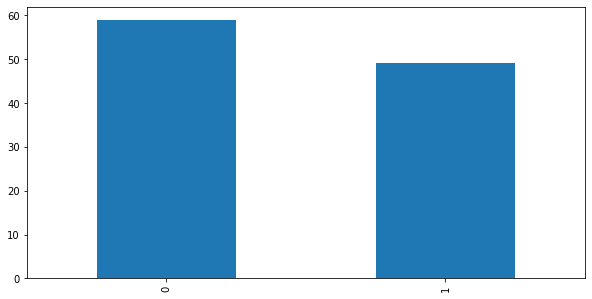

In [41]:
# Plot the cells graphs

fig, ax1 = plt.subplots(1, 1, figsize = (10, 5))
tile_df['cell_type'].value_counts().plot(kind='bar', ax=ax1)

In [42]:
# load in all of the images

from skimage.io import imread
tile_df['image'] = tile_df['path'].map(imread)

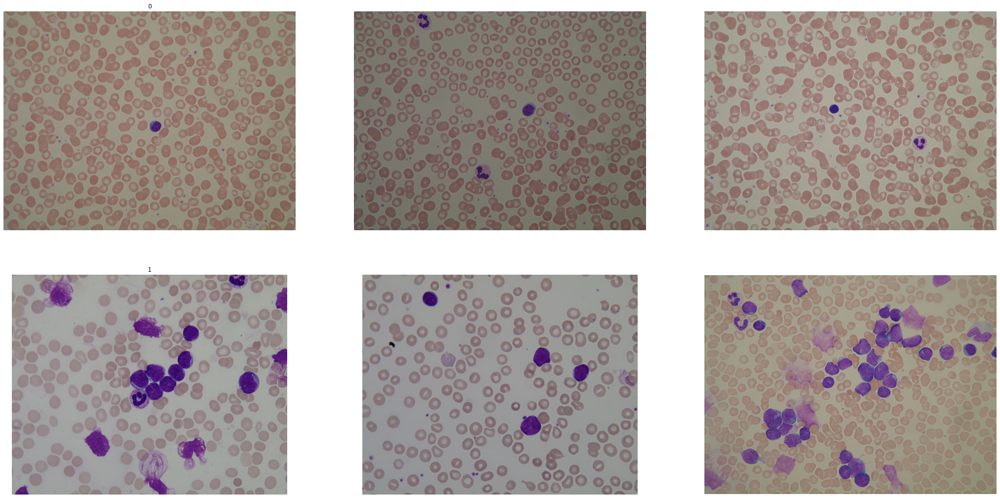

In [43]:
# Visualize the cells categories wih the image database

n_samples = 3
fig, m_axs = plt.subplots(2, n_samples, figsize = (12*n_samples, 3*6))
for n_axs, (type_name, type_rows) in zip(m_axs, 
                                         tile_df.sort_values(['cell_type']).groupby('cell_type')):
    n_axs[0].set_title(type_name)
    for c_ax, (_, c_row) in zip(n_axs, type_rows.sample(n_samples, random_state=2000).iterrows()):
        c_ax.imshow(c_row['image'])
        c_ax.axis('off')
fig.savefig('category_samples.png', dpi=300)

### Get Average Color Information

The further case for normalize all of the color channel information

In [48]:
rgb_info_df = tile_df.apply(lambda x: pd.Series({'{}_mean'.format(k): v for k, v in 
                                  zip(['Red', 'Green', 'Blue'], 
                                      np.mean(x['image'], (0, 1)))}),1)
gray_col_vec = rgb_info_df.apply(lambda x: np.mean(x), 1)
for c_col in rgb_info_df.columns:
    rgb_info_df[c_col] = rgb_info_df[c_col]/gray_col_vec
rgb_info_df['Gray_mean'] = gray_col_vec
rgb_info_df.sample(5)

,Red_mean,Green_mean,Blue_mean,Gray_mean
2,1.093257,0.991516,0.915227,144.936731
59,1.023947,0.964348,1.011705,146.852158
28,1.080277,0.995970,0.923753,146.677150
19,1.045229,0.995243,0.959527,154.422141
29,1.094558,0.995558,0.909884,133.950822


In [49]:
tile_info_df = pd.concat([tile_df, rgb_info_df], 1, sort=True)
tile_info_df.sample(5)

,path,file_id,cell_type,cell_type_idx,full_image_name,full_image_row,full_image_col,image,Red_mean,Green_mean,Blue_mean,Gray_mean
41,..\model\data\ALL-IDB\ALL_IDB1\im\0\Im091_0.jpg,0,0,0,0,0,0,"[[[123, 110, 93], [121, 108, 91], [119, 104, 8...",1.094853,0.997334,0.907813,136.234260
56,..\model\data\ALL-IDB\ALL_IDB1\im\0\Im106_0.jpg,0,0,0,0,0,0,"[[[100, 80, 69], [102, 82, 71], [100, 82, 70],...",1.118273,0.988209,0.893518,106.467925
47,..\model\data\ALL-IDB\ALL_IDB1\im\0\Im097_0.jpg,0,0,0,0,0,0,"[[[91, 72, 68], [90, 71, 67], [90, 71, 67], [9...",1.119905,0.993025,0.887071,98.711200
16,..\model\data\ALL-IDB\ALL_IDB1\im\0\Im066_0.jpg,0,0,0,0,0,0,"[[[157, 161, 147], [161, 165, 151], [158, 162,...",1.046191,0.996755,0.957053,150.808579
40,..\model\data\ALL-IDB\ALL_IDB1\im\0\Im090_0.jpg,0,0,0,0,0,0,"[[[139, 144, 121], [140, 145, 122], [139, 144,...",1.099359,0.997077,0.903564,135.094771


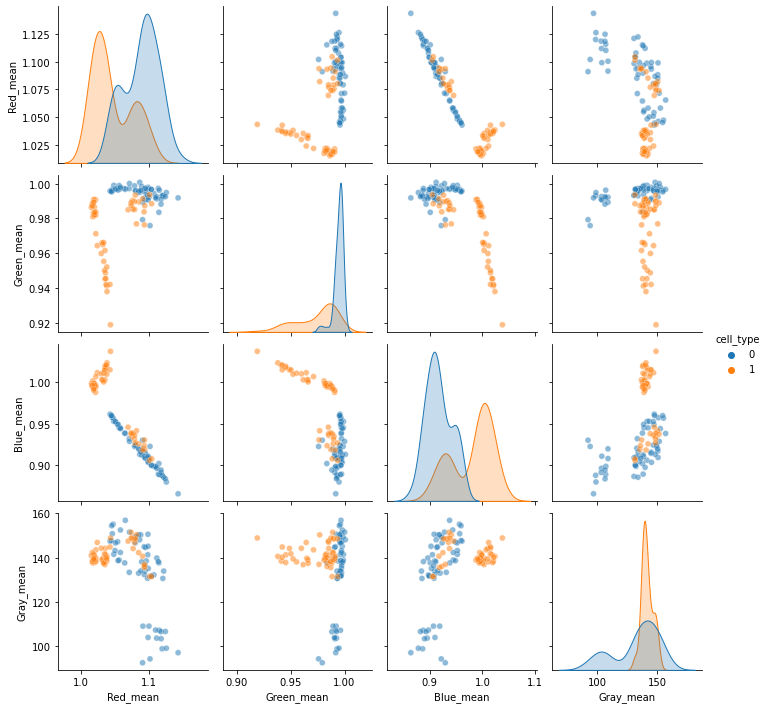

In [46]:
sns.pairplot(tile_info_df[['Red_mean', 'Green_mean', 'Blue_mean', 'Gray_mean', 'cell_type']], 
             hue='cell_type', plot_kws = {'alpha': 0.5})

### Show Color Range

the mean color channel values affect images

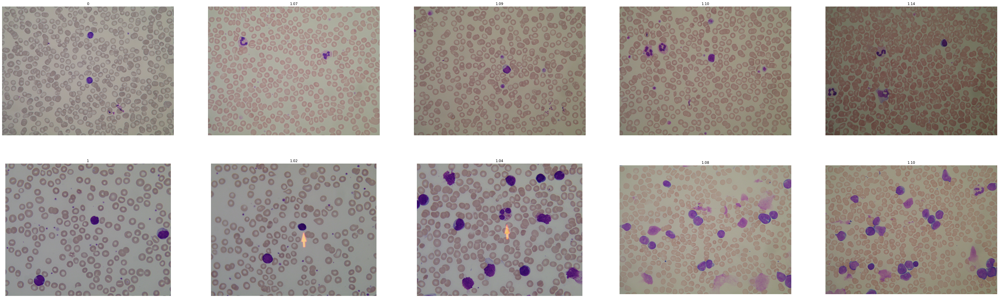

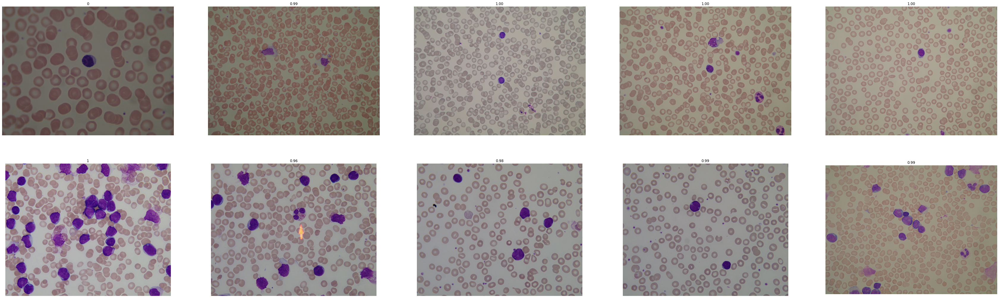

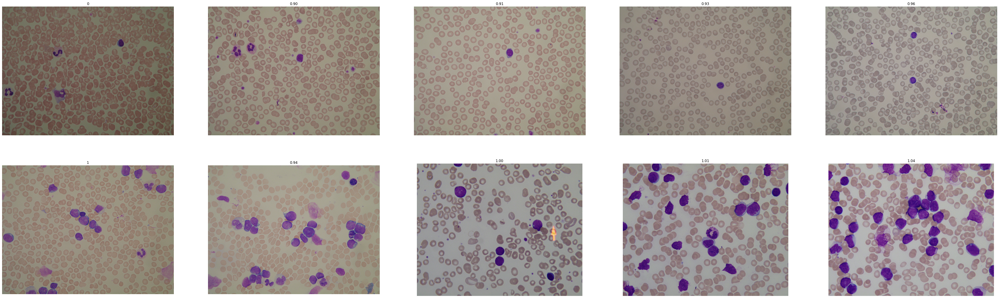

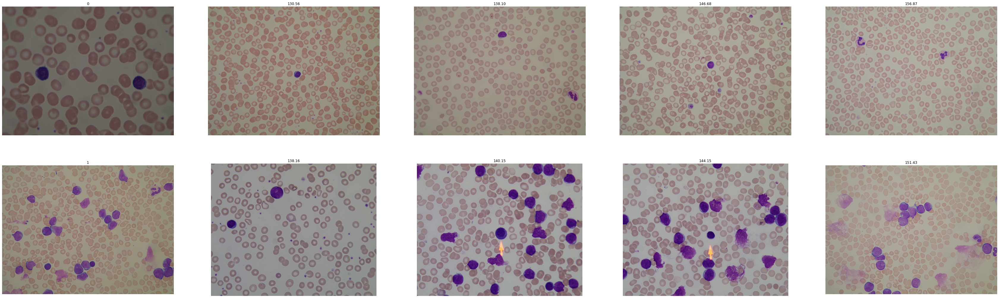

In [47]:
n_samples = 5
for sample_col in ['Red_mean', 'Green_mean', 'Blue_mean', 'Gray_mean']:
    fig, m_axs = plt.subplots(2, n_samples, figsize = (12*n_samples, 3*6))
    def take_n_space(in_rows, val_col, n):
        s_rows = in_rows.sort_values([val_col])
        s_idx = np.linspace(0, s_rows.shape[0]-1, n, dtype=int)
        return s_rows.iloc[s_idx]
    for n_axs, (type_name, type_rows) in zip(m_axs, 
                                             tile_info_df.sort_values(['cell_type']).groupby('cell_type')):

        for c_ax, (_, c_row) in zip(n_axs, 
                                    take_n_space(type_rows, 
                                                 sample_col,
                                                 n_samples).iterrows()):
            c_ax.imshow(c_row['image'])
            c_ax.axis('off')
            c_ax.set_title('{:2.2f}'.format(c_row[sample_col]))
        n_axs[0].set_title(type_name)
    fig.savefig('{}_samples.png'.format(sample_col), dpi=300)

### Conclusion 

The data provided for project are essential to have image processing techniques as the texture from the cell types are clearly defined that the purple and violet spots are essential to spot for the lukemia identification. The two classes which is the healthy cells and lymphoblasts cells are observed. 